In [1]:
import warnings
warnings.filterwarnings('ignore')

In [15]:
import pandas as pd
import numpy as np
import scipy
from collections import Counter

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.metrics import classification_report, accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from sklearn.metrics import plot_confusion_matrix
from sklearn.decomposition import PCA

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from sklearn.model_selection import GridSearchCV

# Pre-processing

In [16]:
df = pd.read_csv('../data/creditcard.csv')
df['V14_17'] = df.V14 * df.V17
df['V_7_16'] = df.V7 * df.V16
df['V3_12'] = df.V3 * df.V12
# df_mod = df_mod.drop(['V14', 'V17' , 'V7', 'V16', 'V3', 'V12'], axis=1)

In [17]:
X = df.drop('Class', axis=1)
y = df.Class

In [18]:
pca = PCA(n_components=5)
X_pca = pca.fit_transform(X)

In [24]:
components = pd.DataFrame(X_pca)
components['Class'] = y
components.corr().Class

0        0.012323
1        0.005548
2        0.537397
3       -0.221629
4       -0.031032
Class    1.000000
Name: Class, dtype: float64

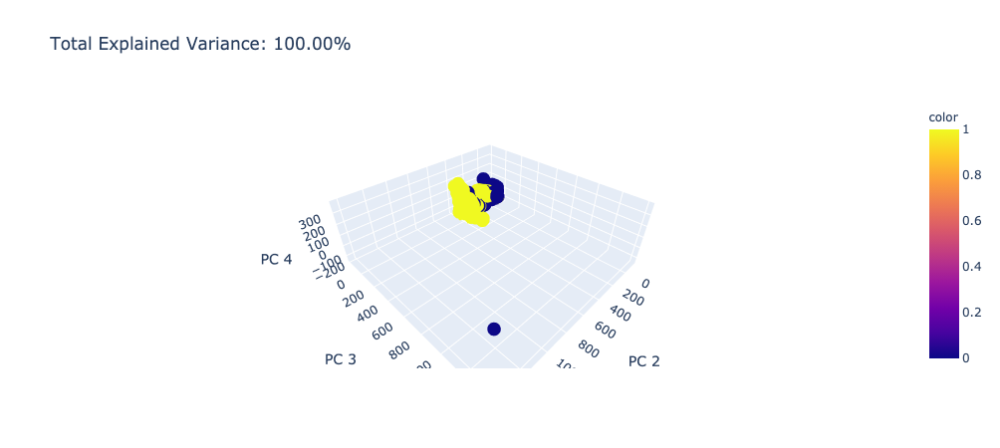

In [25]:
explained_var = pca.explained_variance_ratio_
total_var = explained_var.sum() * 100

fig = px.scatter_3d(
    components, x=2, y=3, z=4, color=df.Class,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'2': 'PC 2', '3': 'PC 3', '4': 'PC 4'}
)
fig.show()

In [26]:
explained_var

array([9.99972214e-01, 2.77388508e-05, 2.66820859e-08, 6.21869932e-09,
       2.78932877e-09])

In [27]:
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, stratify=y, random_state=42)


In [28]:
rfc_pca = RandomForestClassifier(random_state=1)
rfc_pca.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=1, verbose=0,
                       warm_start=False)

In [29]:
y_pred = rfc_pca.predict(X_test)
print(classification_report(y_test, y_pred))
print(f1_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     71079
           1       0.94      0.80      0.86       123

    accuracy                           1.00     71202
   macro avg       0.97      0.90      0.93     71202
weighted avg       1.00      1.00      1.00     71202

0.8634361233480178


In [9]:
weight = {0: len(df[df.Class==0])/len(df), 1:len(df[df.Class==1])/len(df)}
model = RandomForestClassifier(class_weight=weight)

params = {
    'n_estimators':[20, 50],
}

gs = GridSearchCV(model, params, scoring='f1', verbose=1)
gs.fit(X_pca, y)

Fitting 5 folds for each of 2 candidates, totalling 10 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:  4.5min finished


GridSearchCV(cv=None, error_score=nan,
             estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                              class_weight={0: 0.9982725143693799,
                                                            1: 0.001727485630620034},
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              max_samples=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators=100, n_jobs=None,
       

In [10]:
gs.best_params_

{'n_estimators': 20}

In [36]:
weight = {0: len(df[df.Class==0])/len(df), 1:len(df[df.Class==1])/len(df)}
rfc_tune = RandomForestClassifier(random_state=1, class_weight=weight)
rfc_tune.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                       class_weight={0: 0.9982725143693799,
                                     1: 0.001727485630620034},
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=1, verbose=0,
                       warm_start=False)

In [37]:
y_pred = rfc_tune.predict(X_test)
print(classification_report(y_test, y_pred))
print(f1_score(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     71079
           1       0.93      0.80      0.86       123

    accuracy                           1.00     71202
   macro avg       0.96      0.90      0.93     71202
weighted avg       1.00      1.00      1.00     71202

0.8608695652173913
